<a href="https://colab.research.google.com/github/intheblueside/spotify-popularity/blob/main/Sample_%26_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import dataset from Hugging Face

In [ ]:
!pip install datasets

In [ ]:
import pandas as pd

df = pd.read_parquet("https://huggingface.co/api/datasets/maharshipandya/spotify-tracks-dataset/parquet/default/train/0000.parquet")

In [ ]:
print(df.head())

   Unnamed: 0                track_id                 artists  \
0           0  5SuOikwiRyPMVoIQDJUgSV             Gen Hoshino   
1           1  4qPNDBW1i3p13qLCt0Ki3A            Ben Woodward   
2           2  1iJBSr7s7jYXzM8EGcbK5b  Ingrid Michaelson;ZAYN   
3           3  6lfxq3CG4xtTiEg7opyCyx            Kina Grannis   
4           4  5vjLSffimiIP26QG5WcN2K        Chord Overstreet   

                                          album_name  \
0                                             Comedy   
1                                   Ghost (Acoustic)   
2                                     To Begin Again   
3  Crazy Rich Asians (Original Motion Picture Sou...   
4                                            Hold On   

                   track_name  popularity  duration_ms  explicit  \
0                      Comedy          73       230666     False   
1            Ghost - Acoustic          55       149610     False   
2              To Begin Again          57       210826     False   


# Sampling

In [ ]:
df.shape

(114000, 21)

In [ ]:
sample_size = 0.1 * len(df)
sample_size = int(sample_size)
df = df.sample(n=sample_size)

In [ ]:
df.shape

(11400, 21)

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
df.to_csv('/content/drive/MyDrive/dataset_afterEDA.csv')

# EDA

## Automated Report using Pandas-Profiling

In [ ]:
!pip install pandas-profiling
!pip install 'pydantic<2'

  Using cached pydantic-2.10.4-py3-none-any.whl.metadata (29 kB)
Using cached pydantic-2.10.4-py3-none-any.whl (431 kB)
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.19
    Uninstalling pydantic-1.10.19:
      Successfully uninstalled pydantic-1.10.19
  Using cached pydantic-1.10.19-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (152 kB)
Using cached pydantic-1.10.19-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.1 MB)
  Attempting uninstall: pydantic
    Found existing installation: pydantic 2.10.4
    Uninstalling pydantic-2.10.4:
      Successfully uninstalled pydantic-2.10.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 1.4.20 requires pydantic>=2.7.0, but you have pydantic 1.10.19 which is incompatible.
google-genai 0.3.0 requires pydantic<3.0.0dev,>=2.0.0, but you have 

In [ ]:
from ydata_profiling import ProfileReport

profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Pie Charts using Plotly

In [ ]:
popularsongs = df[df['popularity']>=70]
popularsongs.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
19250,19250,1YYhDizHx7PnDhAhko6cDS,John Denver,"Poems, Prayers and Promises","Take Me Home, Country Roads",73,190160,False,0.462,0.395,9,-9.376,1,0.0264,0.7580,0.000000,0.121,0.6250,82.259,4,country
86254,86254,5dTHtzHFPyi8TlTtzoz1J9,My Chemical Romance,Three Cheers for Sweet Revenge,Helena,76,204733,False,0.356,0.960,4,-3.487,1,0.1040,0.0142,0.000000,0.209,0.0857,125.921,4,punk
47109,47109,4OROzZUy6gOWN4UGQVaZMF,Iron Maiden,Piece of Mind (2015 Remaster),The Trooper - 2015 Remaster,75,252733,False,0.285,0.908,4,-4.601,0,0.0705,0.0318,0.009090,0.311,0.6690,159.756,4,hard-rock
31963,31963,5o5akY9xnEk6lpMkD8RwD9,Melanie Martinez,K-12,Teacher's Pet,76,241893,True,0.686,0.794,7,-6.136,0,0.0385,0.2700,0.000023,0.125,0.5320,140.952,3,electro
3570,3570,57iDDD9N9tTWe75x6qhStw,The Verve,Urban Hymns (Remastered 2016),Bitter Sweet Symphony,80,357266,False,0.356,0.917,9,-6.006,1,0.0479,0.0335,0.000000,0.406,0.5180,171.176,4,alternative


> Percentage of explicit songs

In [ ]:
import plotly.express as px

fig = px.pie(popularsongs, names='explicit',
             title='Percentage of Popular Songs with Explicit Lyrics',height=600, width=600)
fig.show()

> Percentage of Track Genre

In [ ]:
unique_genres = df['track_genre'].unique()
unique_genres

array(['happy', 'power-pop', 'country', 'bluegrass', 'r-n-b',
       'drum-and-bass', 'idm', 'study', 'punk', 'j-dance', 'metal',
       'grunge', 'emo', 'brazil', 'sleep', 'psych-rock', 'disco', 'blues',
       'club', 'reggae', 'forro', 'kids', 'garage', 'industrial', 'dub',
       'mpb', 'dubstep', 'salsa', 'show-tunes', 'chicago-house', 'rock',
       'sertanejo', 'minimal-techno', 'jazz', 'edm', 'anime', 'german',
       'latin', 'trip-hop', 'death-metal', 'heavy-metal', 'french',
       'pagode', 'classical', 'punk-rock', 'world-music', 'mandopop',
       'comedy', 'deep-house', 'j-rock', 'hard-rock', 'samba', 'electro',
       'spanish', 'folk', 'chill', 'gospel', 'rockabilly', 'pop',
       'metalcore', 'house', 'reggaeton', 'indie', 'indian', 'hardcore',
       'alternative', 'malay', 'british', 'funk', 'soul', 'goth',
       'detroit-techno', 'pop-film', 'tango', 'indie-pop', 'hip-hop',
       'songwriter', 'progressive-house', 'turkish', 'trance', 'latino',
       'techno', 

In [ ]:
import pandas as pd

genres = ['acoustic', 'afrobeat', 'alt-rock', 'alternative', 'ambient',
       'anime', 'black-metal', 'bluegrass', 'blues', 'brazil',
       'breakbeat', 'british', 'cantopop', 'chicago-house', 'children',
       'chill', 'classical', 'club', 'comedy', 'country', 'dance',
       'dancehall', 'death-metal', 'deep-house', 'detroit-techno',
       'disco', 'disney', 'drum-and-bass', 'dub', 'dubstep', 'edm',
       'electro', 'electronic', 'emo', 'folk', 'forro', 'french', 'funk',
       'garage', 'german', 'gospel', 'goth', 'grindcore', 'groove',
       'grunge', 'guitar', 'happy', 'hard-rock', 'hardcore', 'hardstyle',
       'heavy-metal', 'hip-hop', 'honky-tonk', 'house', 'idm', 'indian',
       'indie-pop', 'indie', 'industrial', 'iranian', 'j-dance', 'j-idol',
       'j-pop', 'j-rock', 'jazz', 'k-pop', 'kids', 'latin', 'latino',
       'malay', 'mandopop', 'metal', 'metalcore', 'minimal-techno', 'mpb',
       'new-age', 'opera', 'pagode', 'party', 'piano', 'pop-film', 'pop',
       'power-pop', 'progressive-house', 'psych-rock', 'punk-rock',
       'punk', 'r-n-b', 'reggae', 'reggaeton', 'rock-n-roll', 'rock',
       'rockabilly', 'romance', 'sad', 'salsa', 'samba', 'sertanejo',
       'show-tunes', 'singer-songwriter', 'ska', 'sleep', 'songwriter',
       'soul', 'spanish', 'study', 'swedish', 'synth-pop', 'tango',
       'techno', 'trance', 'trip-hop', 'turkish', 'world-music']


In [ ]:
general_genre_mapping = {
    'Pop': ['pop', 'synth-pop', 'power-pop', 'mandopop', 'cantopop', 'j-pop', 'k-pop', 'indie-pop'],
    'Rock': ['rock', 'alt-rock', 'punk-rock', 'hard-rock', 'psych-rock', 'rock-n-roll', 'grunge', 'garage',
             'metalcore', 'heavy-metal', 'black-metal', 'death-metal', 'hardcore'],
    'Electronic': ['electronic', 'edm', 'house', 'deep-house', 'progressive-house', 'techno',
                   'detroit-techno', 'minimal-techno', 'dubstep', 'trance', 'club', 'chicago-house',
                   'electro', 'hardstyle', 'ambient'],
    'Classical': ['classical', 'opera', 'piano'],
    'Jazz': ['jazz', 'blues', 'funk', 'soul', 'groove'],
    'Hip-Hop': ['hip-hop', 'r-n-b', 'gospel'],
    'Latin': ['latin', 'salsa', 'pagode', 'tango', 'mpb', 'brazil', 'sertanejo', 'forro'],
    'Country': ['country', 'honky-tonk', 'bluegrass'],
    'World': ['world-music', 'afrobeat', 'reggae', 'dancehall', 'dub', 'iranian', 'indian',
              'turkish', 'malay', 'french', 'german', 'swedish', 'spanish'],
    'Metal': ['metal', 'heavy-metal', 'death-metal', 'black-metal', 'grindcore'],
    'Folk': ['folk', 'acoustic', 'singer-songwriter', 'songwriter'],
    'Children': ['children', 'kids', 'disney'],
    'Dance': ['dance', 'party', 'disco', 'breakbeat', 'happy'],
    'Alternative': ['alternative', 'emo', 'indie', 'j-idol', 'j-rock'],
    'Experimental': ['idm', 'industrial', 'trip-hop'],
    'Other': ['anime', 'show-tunes', 'pop-film', 'study', 'romance', 'sleep']
}

def map_to_general_genre(genre):
    for general_genre, specific_genres in general_genre_mapping.items():
        if genre in specific_genres:
            return general_genre
    return 'Uncategorized'

df['track_genre'] = df['track_genre'].apply(map_to_general_genre)

In [ ]:
df.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
46221,46221,31JhTEAWmmhZIZTm40pQZr,Scooter,No Time To Chill,How Much Is The Fish?,60,227000,False,0.530,0.994,2,-9.629,0,0.0615,0.000592,0.00708,0.3640,0.681,139.992,4,Dance
82274,82274,7CYrVoeNQ1N6JnZkckmW1q,The Marked Men,Fix My Brain,"Wait Here, Wait for You",26,119480,False,0.241,0.972,0,-3.392,1,0.0663,0.006130,0.51800,0.3330,0.504,192.013,4,Pop
19250,19250,1YYhDizHx7PnDhAhko6cDS,John Denver,"Poems, Prayers and Promises","Take Me Home, Country Roads",73,190160,False,0.462,0.395,9,-9.376,1,0.0264,0.758000,0.00000,0.1210,0.625,82.259,4,Country
7584,7584,5RE2ifRcAE1qILd7tGWKpU,Jerry Garcia Band;Jerry Garcia,Cats Under the Stars (Expanded),Rain,24,353986,False,0.574,0.510,7,-8.394,1,0.0237,0.093100,0.00433,0.0659,0.507,106.338,4,Country
87696,87696,60iXCl8pczSf8TqN0yUaH4,RPM,Radio Pirata Ao Vivo,Olhar 43,41,193733,False,0.388,0.987,10,-5.936,1,0.1070,0.032000,0.05780,0.9770,0.405,162.988,4,Hip-Hop


In [ ]:
fig = px.pie(popularsongs, title='Track Genre Percentage of Popular Songs',names='track_genre',
             height=600, width=600)
fig.show()

> Percentage of Average Song Duration

In [ ]:
fig = px.pie(df, names='time_signature', height=600, width=600)
fig.show()

> Modality of Popular Songs

In [ ]:
fig = px.pie(popularsongs, names='mode', title='Modality of Popular Songs',height=600, width=600)
fig.show()

## Distribution Plots using Seaborn

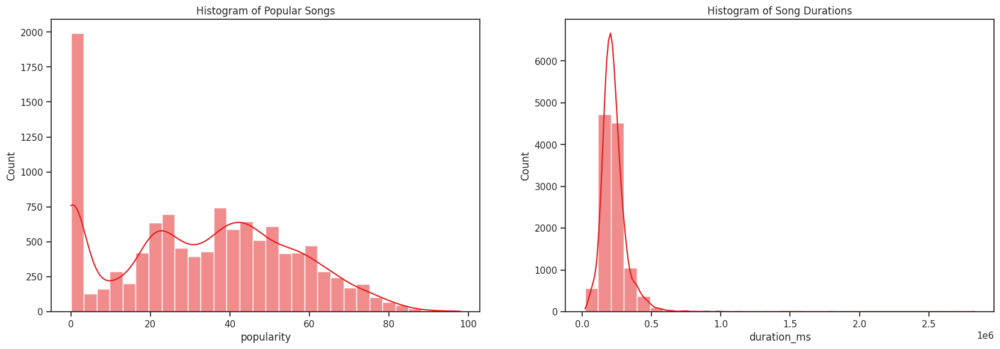

In [ ]:
# Univariate Analysis: Histograms

import seaborn as sns
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.histplot(df['popularity'], bins=30, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Popular Songs')

sns.histplot(df['duration_ms'], bins=30, kde=True, ax=axes[1])
axes[1].set_title('Histogram of Song Durations')

plt.show()

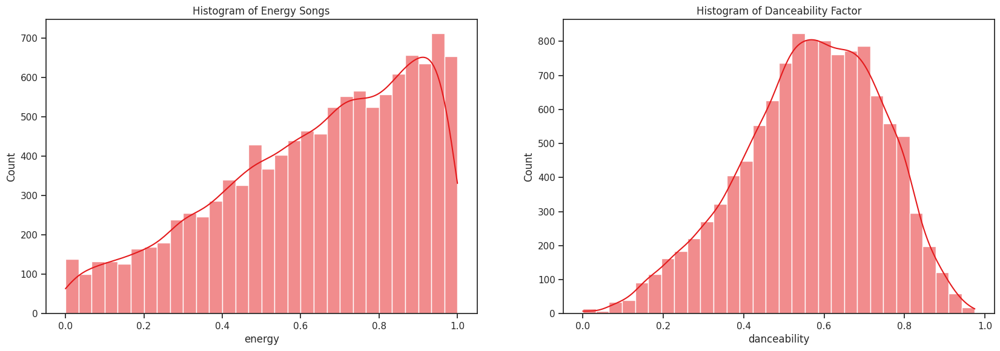

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.histplot(df['energy'], bins=30, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Energy Songs')

sns.histplot(df['danceability'], bins=30, kde=True, ax=axes[1])
axes[1].set_title('Histogram of Danceability Factor')

plt.show()

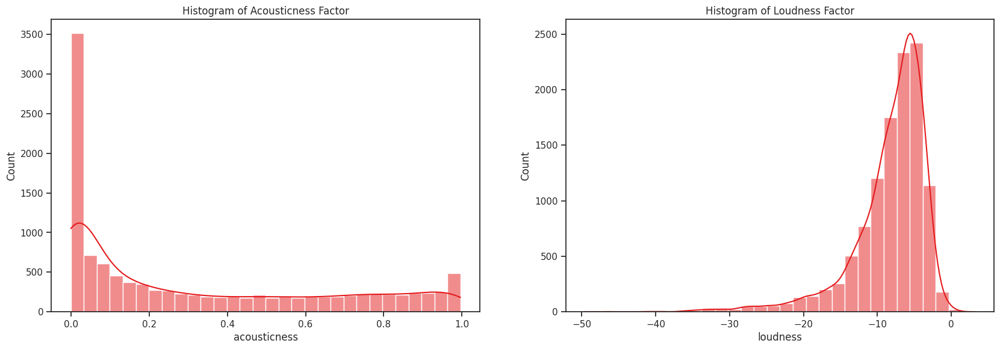

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.histplot(df['acousticness'], bins=30, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Acousticness Factor')

sns.histplot(df['loudness'], bins=30, kde=True, ax=axes[1])
axes[1].set_title('Histogram of Loudness Factor')

plt.show()

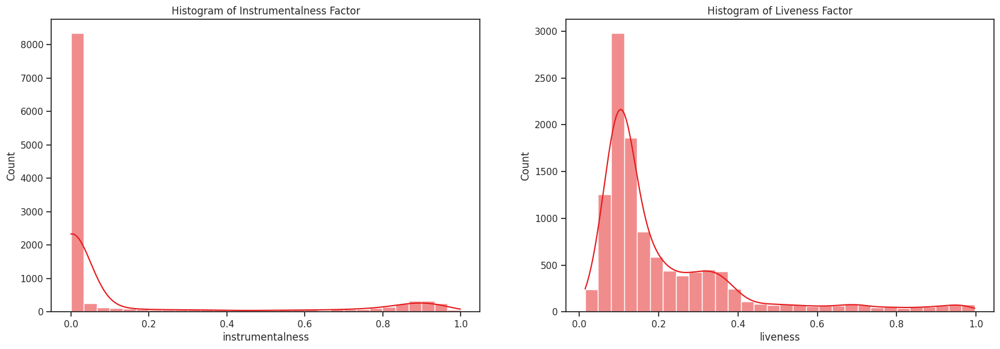

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.histplot(df['instrumentalness'], bins=30, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Instrumentalness Factor')

sns.histplot(df['liveness'], bins=30, kde=True, ax=axes[1])
axes[1].set_title('Histogram of Liveness Factor')

plt.show()

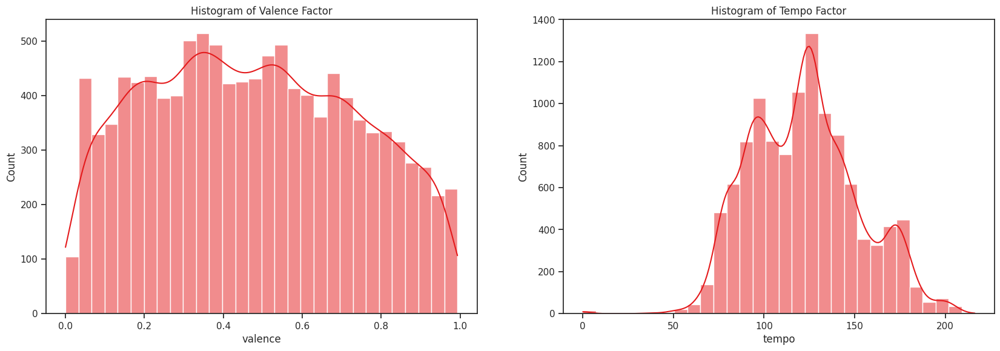

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.histplot(df['valence'], bins=30, kde=True, ax=axes[0])
axes[0].set_title('Histogram of Valence Factor')

sns.histplot(df['tempo'], bins=30, kde=True, ax=axes[1])
axes[1].set_title('Histogram of Tempo Factor')

plt.show()

## Boxplots

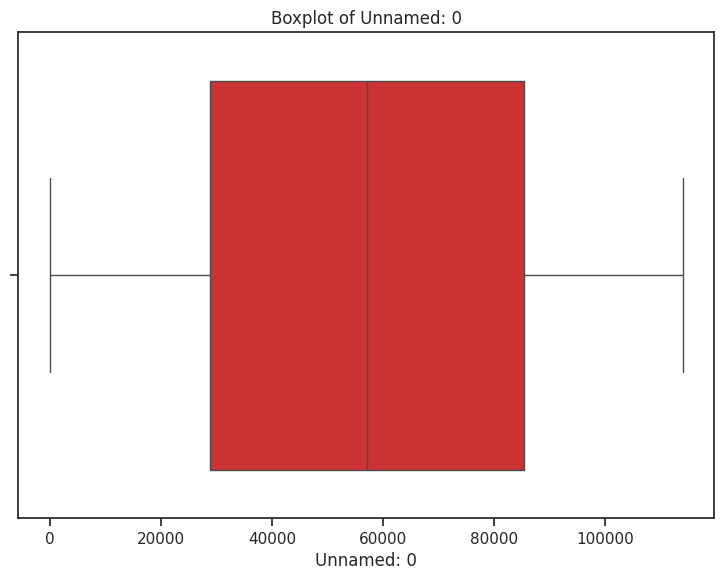

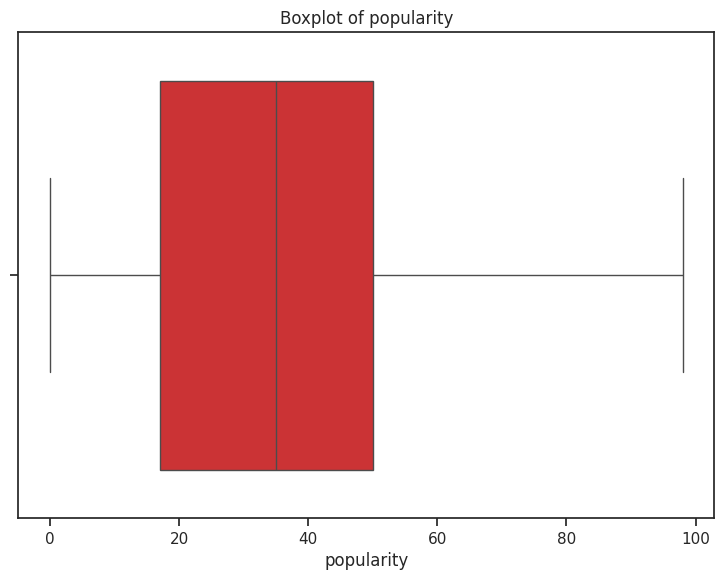

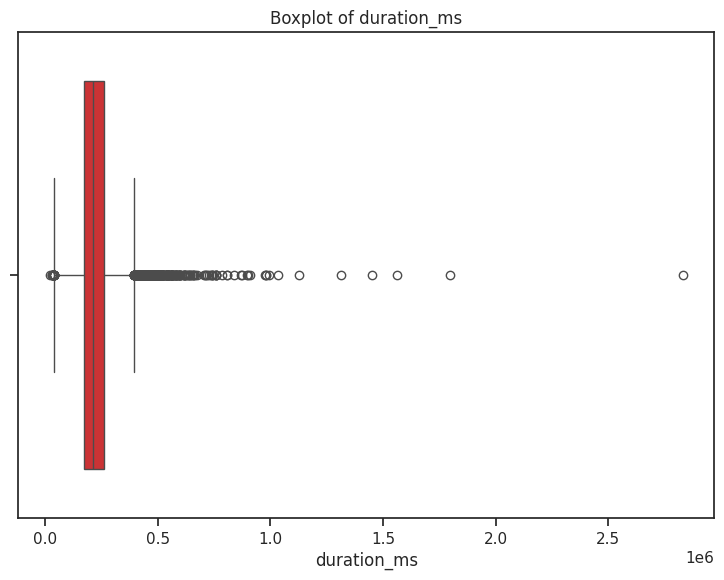

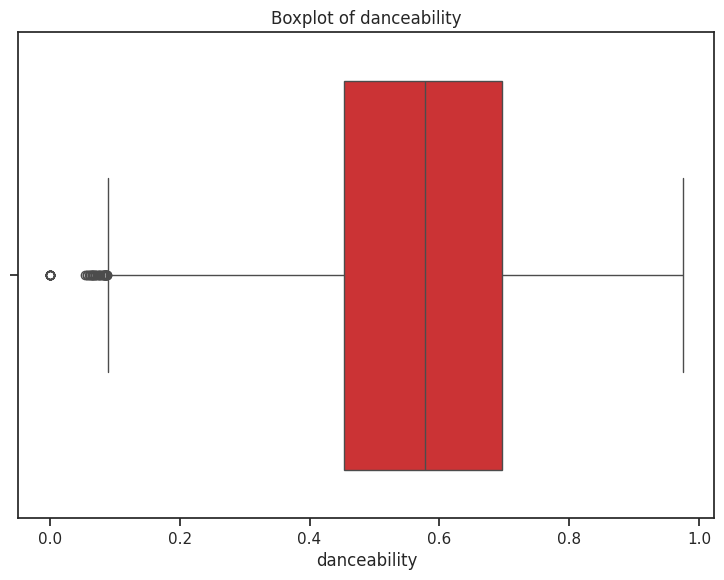

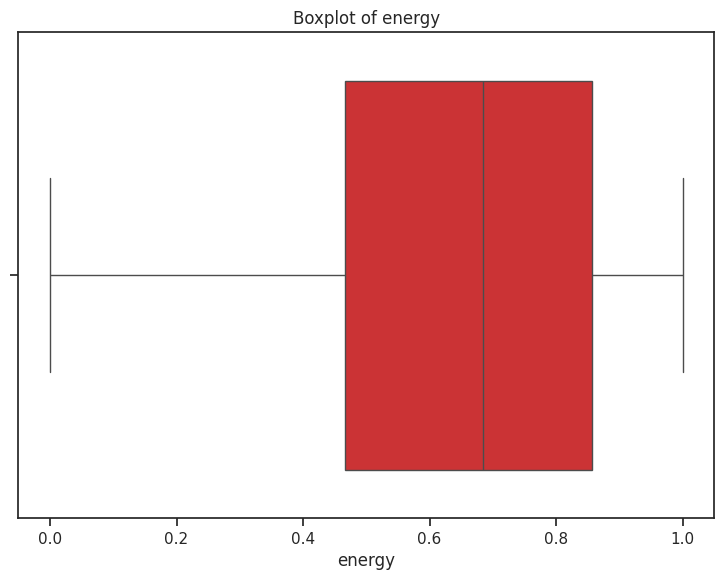

...

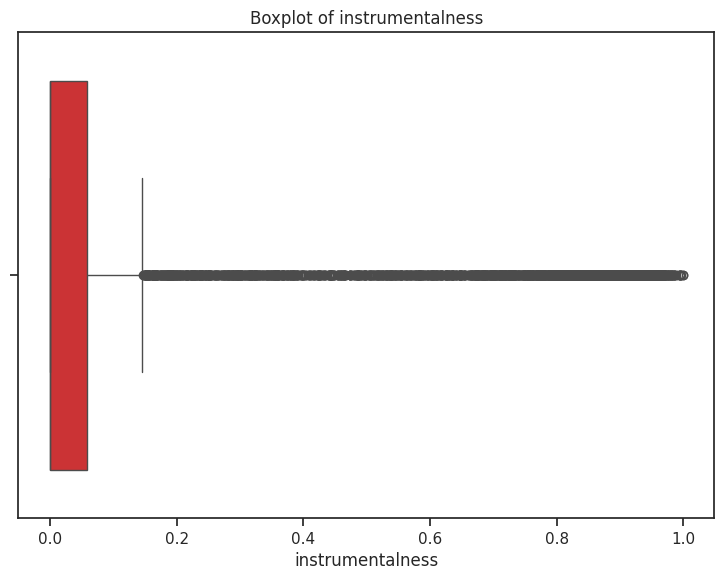

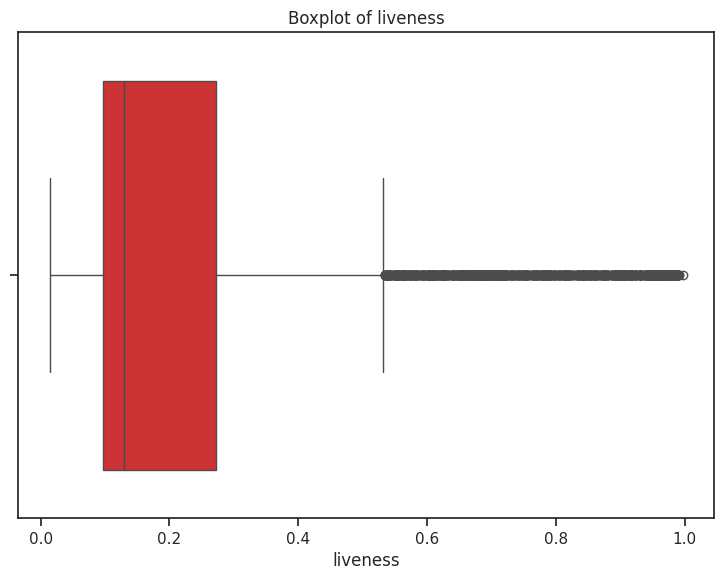

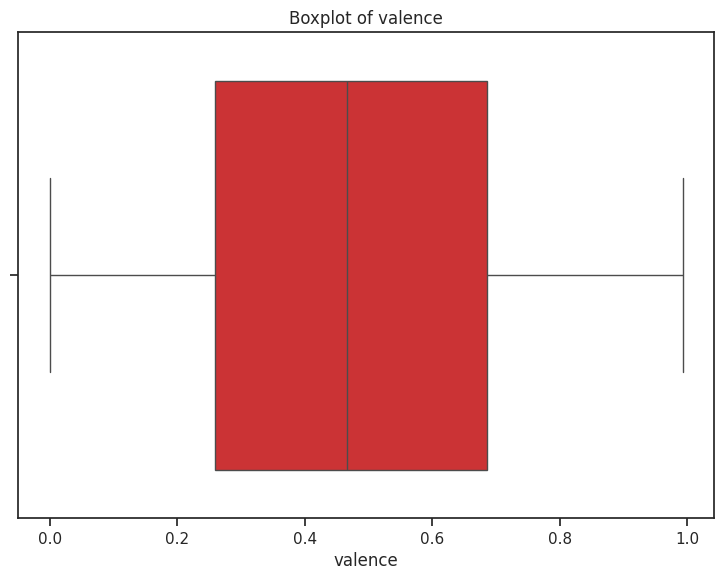

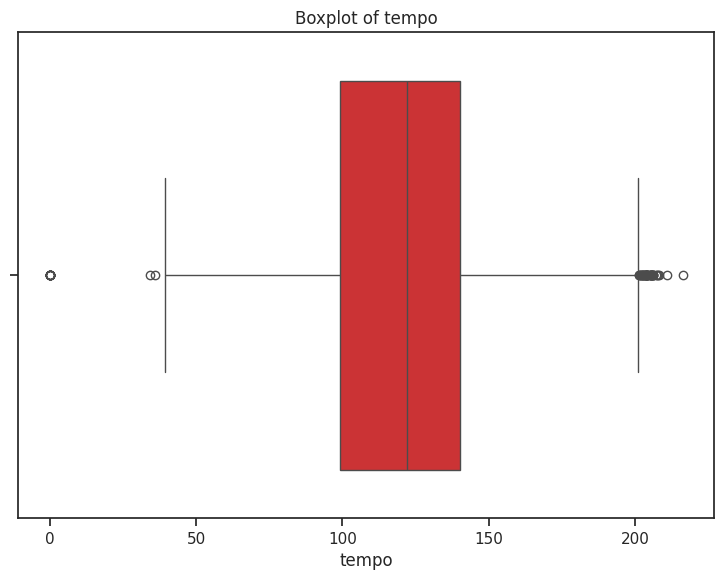

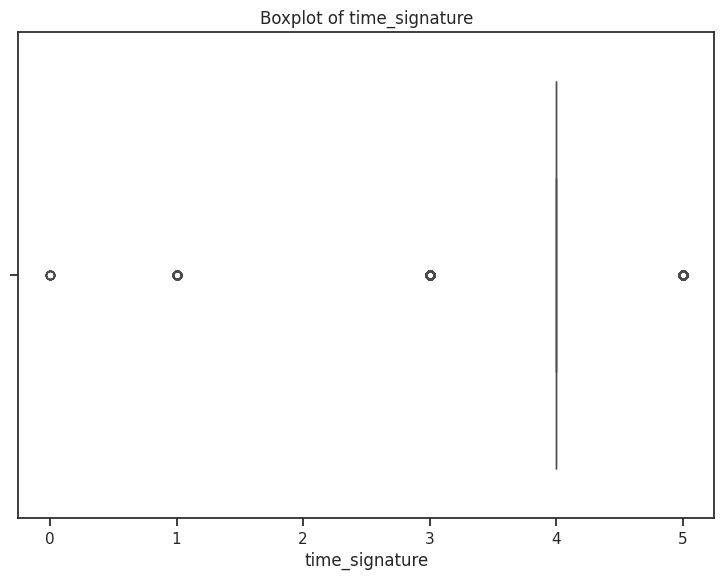

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

numeric_cols = df.select_dtypes(include=['number']).columns

for col in numeric_cols:
  plt.figure(figsize=(8, 6))
  sns.boxplot(x=df[col])
  plt.title(f'Boxplot of {col}')
  plt.show()

## Bivariate Analysis: 2D Scatter Plots using Seaborn

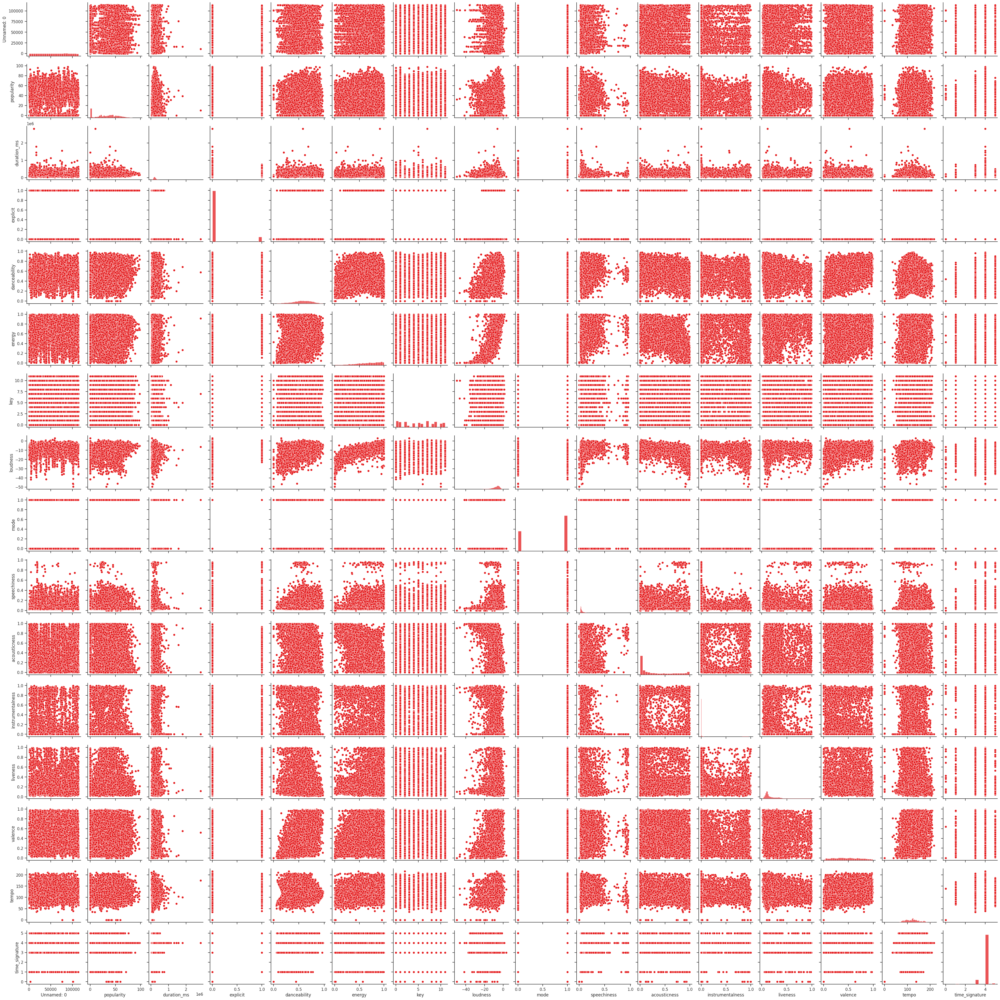

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(df)
plt.show()

> New Feature: Intensity

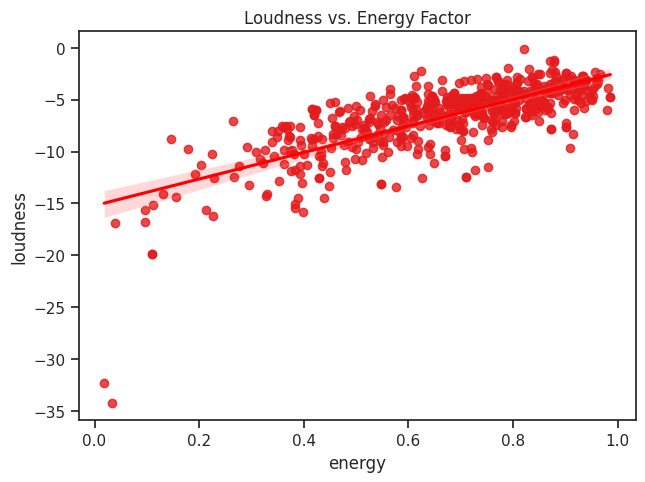

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.regplot(x='energy', y='loudness', data=popularsongs,line_kws={'color': 'red'})
plt.title('Loudness vs. Energy Factor')
plt.show()

> New Feature: Liveliness

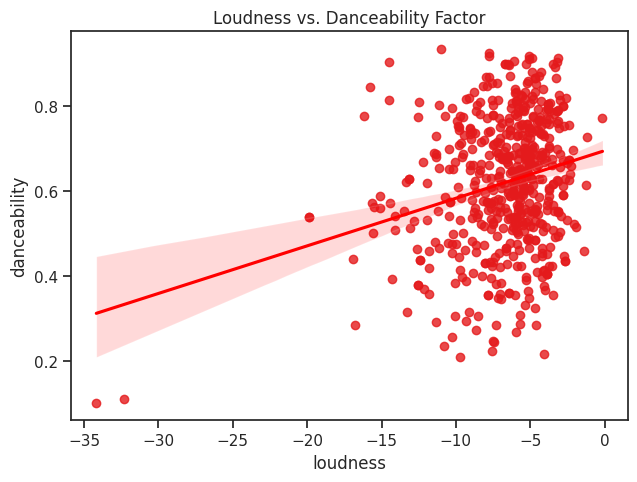

In [ ]:
sns.regplot(x='loudness', y='danceability', data=popularsongs,line_kws={'color': 'red'})
plt.title('Loudness vs. Danceability Factor')
plt.show()

## Trivariate Analysis: 3D Scatter Plots using Plotly

> New Feature: Grooviness

In [ ]:
import plotly.express as px

fig = px.scatter_3d(popularsongs, x='speechiness', y='energy', z='danceability',
                    title = 'Grooviness', color = 'popularity')
fig.show()

## Correlation Heatmap using Seaborn

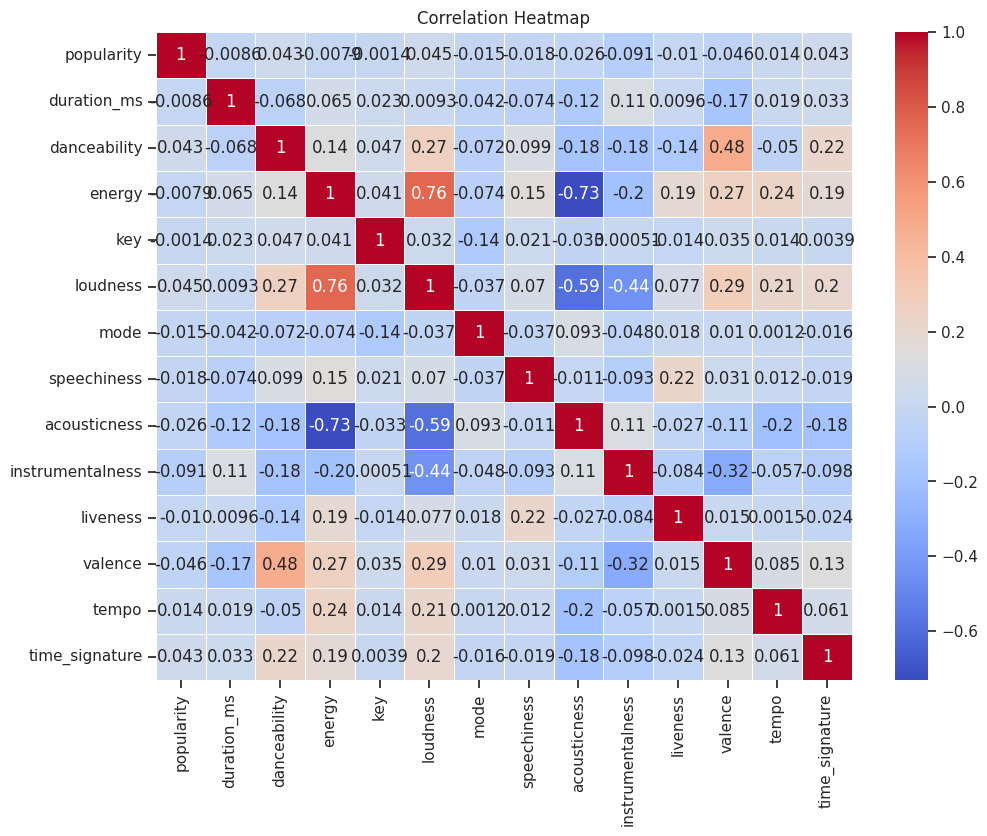

In [ ]:
heatmap_df = df.drop(columns=['Unnamed: 0',	'track_id',	'artists',	'album_name', 'track_name','explicit','track_genre'])
correlation_matrix = heatmap_df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

## AutoViz

In [ ]:
!pip install autoviz

In [ ]:
import numpy as np
from autoviz import AutoViz_Class
%matplotlib inline

AV = AutoViz_Class()

    Since nrows is smaller than dataset, loading random sample of 500 rows into pandas...
Shape of your Data Set loaded: (500, 21)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing up to 30 columns (max) in each category:
    Numeric Columns : ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']
    Integer-Categorical Columns: ['duration_ms', 'key', 'time_signature']
    String-Categorical Columns: ['track_id', 'track_genre']
    Factor-Categorical Columns: []
    String-Boolean Columns: ['explicit']
    Numeric-Boolean Columns: ['mode']
    Discrete String Columns: []
    NLP text Columns: ['artists', 'album_name', 'track_name']
    Date Time Columns: []
    

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
track_id,object,0.000000,99,,,499 rare categories: Too many to list. Group them into a single category or drop the categories.
artists,object,0.000000,94,,,No issue
album_name,object,0.000000,98,,,No issue
track_name,object,0.000000,99,,,No issue
duration_ms,int64,0.000000,99,30222.000000,716079.000000,Column has 25 outliers greater than upper bound (379932.25) or lower than lower bound(46664.25). Cap them or remove them.
explicit,bool,0.000000,0,0.000000,1.000000,No issue
danceability,float64,0.000000,NA,0.000000,0.912000,Column has 3 outliers greater than upper bound (1.04) or lower than lower bound(0.10). Cap them or remove them.
energy,float64,0.000000,NA,0.000252,0.998000,No issue
key,int64,0.000000,2,0.000000,11.000000,No issue
loudness,float64,0.000000,NA,-29.014000,-1.065000,Column has 32 outliers greater than upper bound (2.65) or lower than lower bound(-17.02). Cap them or remove them.


Number of All Scatter Plots = 45


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do


**********************************************************************
  Resource punkt_tab not found.
  Please use the NLTK Downloader to obtain the resource:

  >>> import nltk
  >>> nltk.download('punkt_tab')
  
  For more information see: https://www.nltk.org/data.html

  Attempted to load tokenizers/punkt_tab/english/

  Searched in:
    - '/root/nltk_data'
    - '/usr/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/share/nltk_data'
    - '/usr/local/share/nltk_data'
    - '/usr/lib/nltk_data'
    - '/usr/local/lib/nltk_data'
**********************************************************************

Could not draw wordcloud plot for artists. 
Looks like you are missing some required data for this feature.

To download the necessary data, simply run

    python -m textblob.download_corpora

or use the NLTK downloader to download the missing data: http://nltk.org/data.html
If this doesn't fix the problem, file an issue at https://github.com/sloria/TextBl

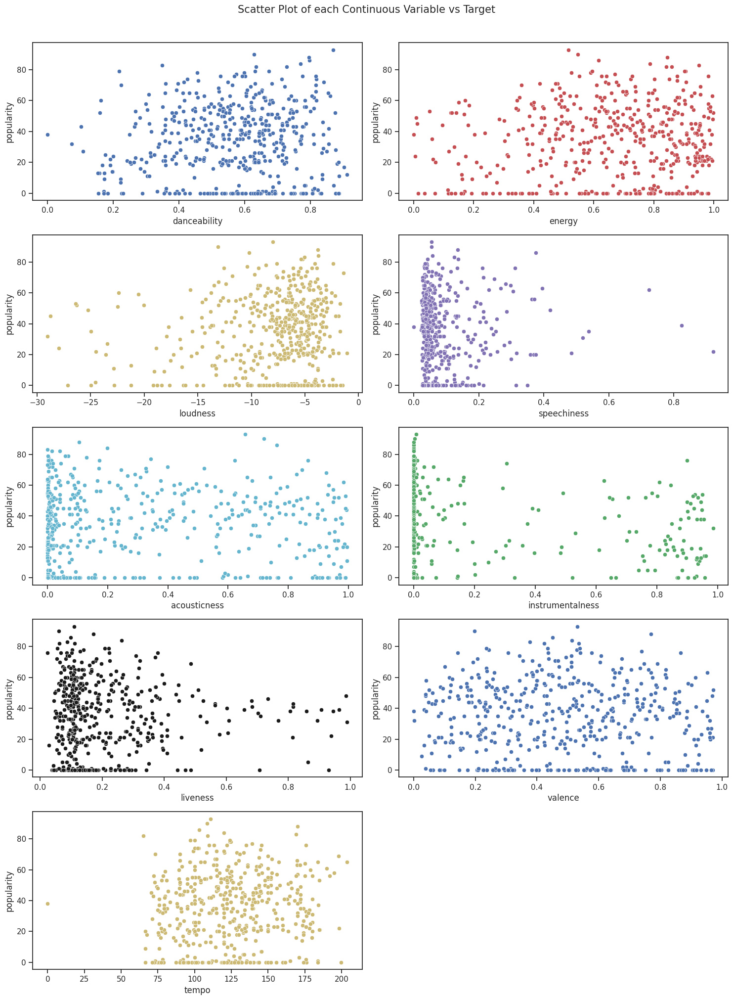

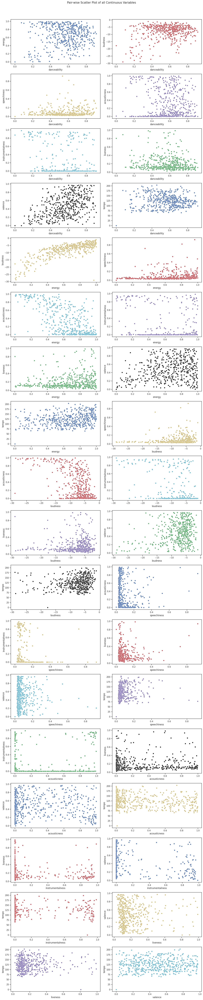

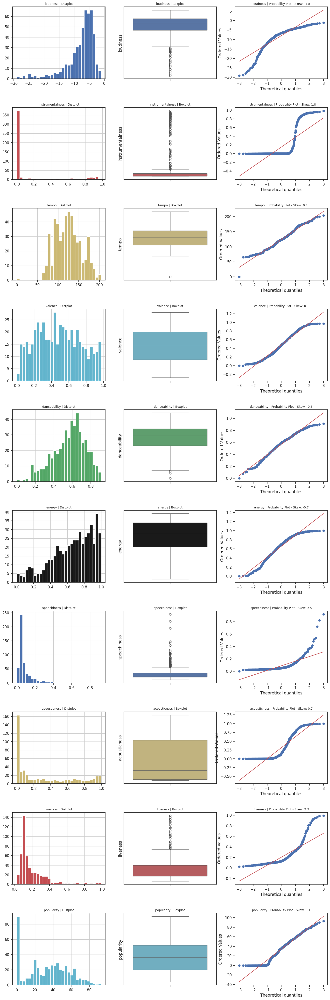

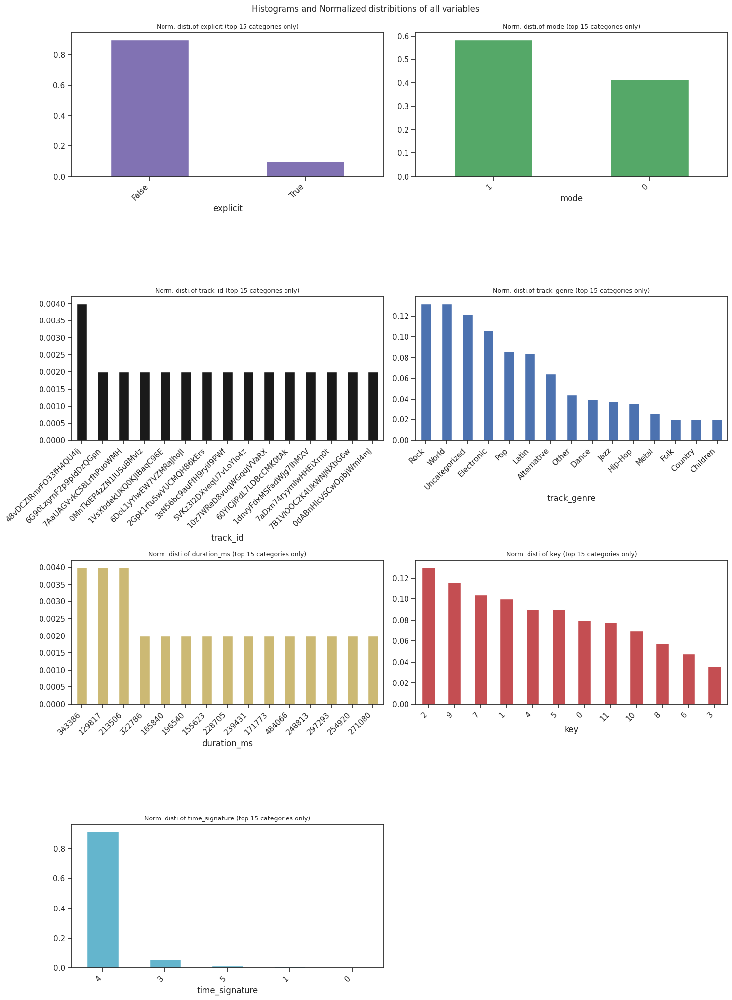

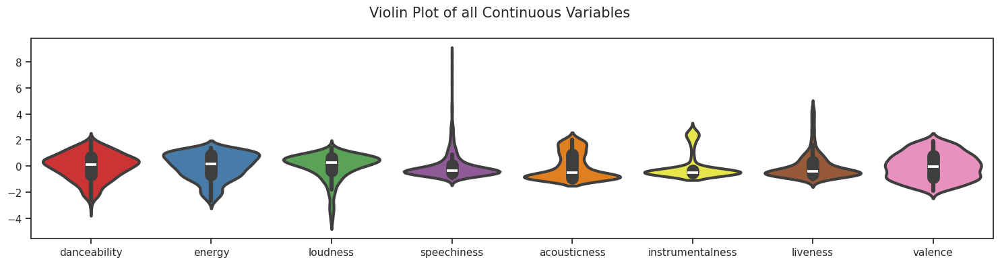

...

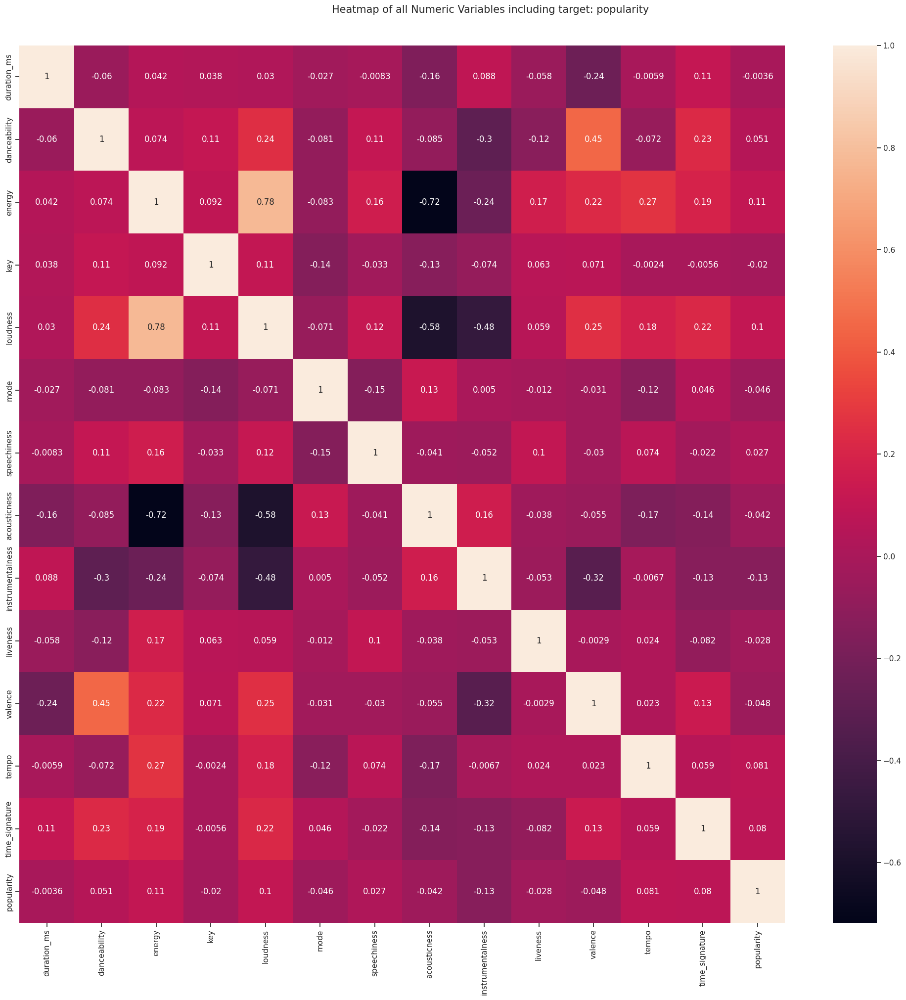

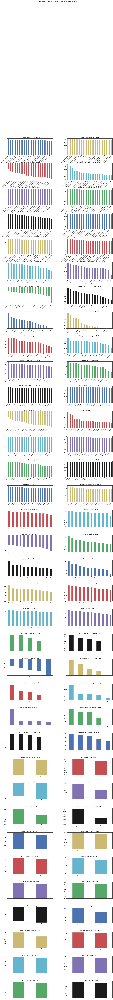

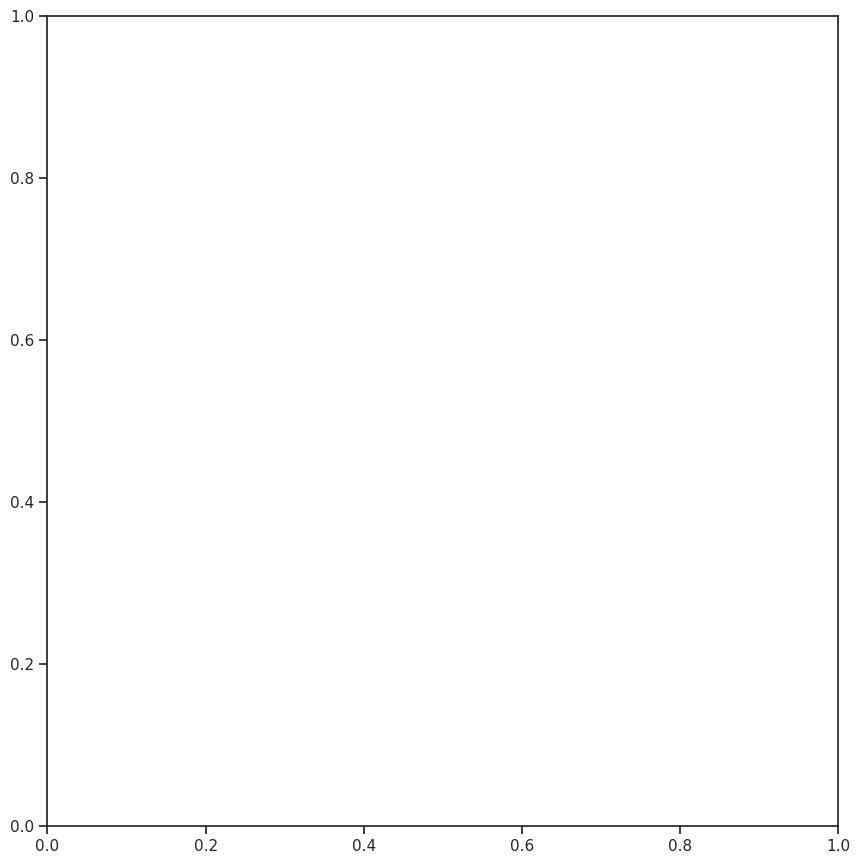

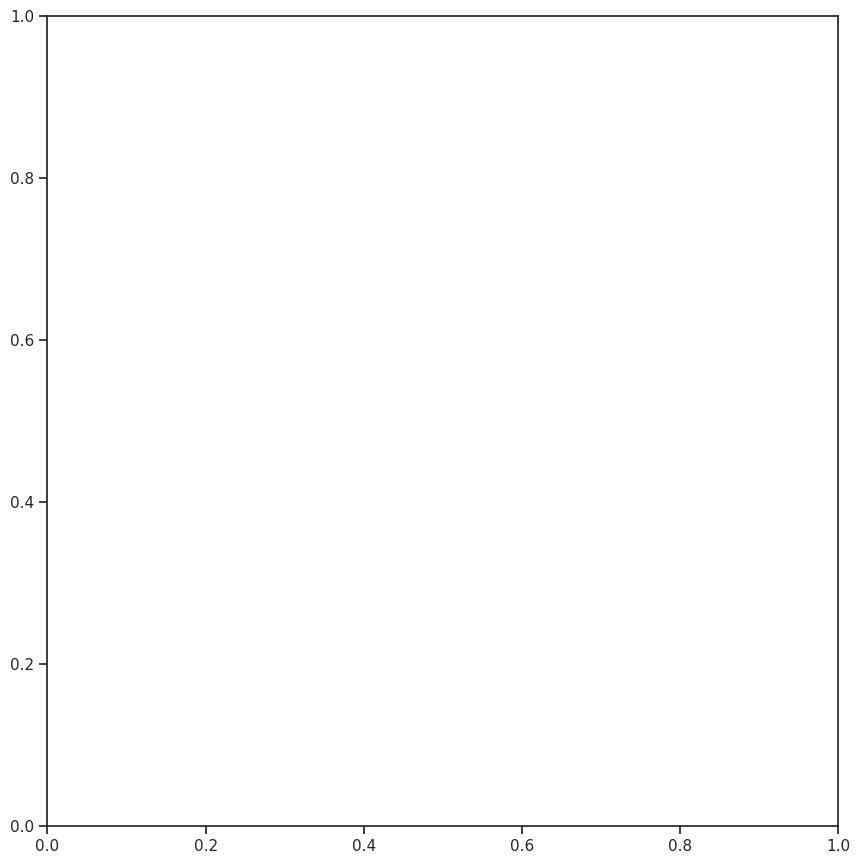

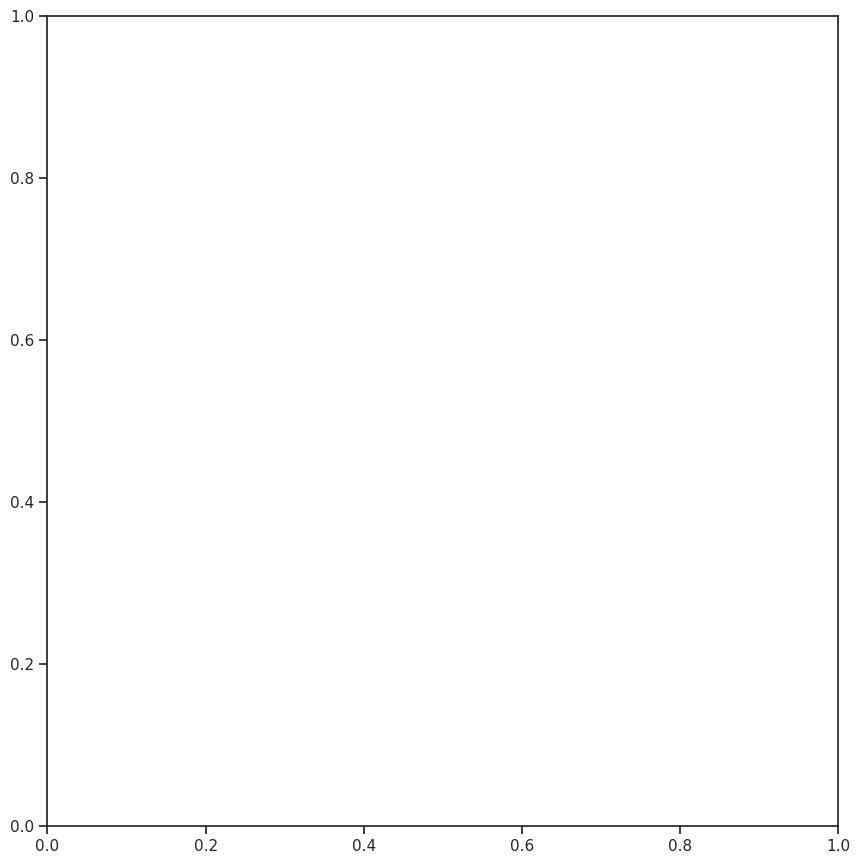

In [ ]:
dft = AV.AutoViz(
    df,
    sep=",",
    depVar="popularity",
    dfte=None,
    header=0,
    verbose=2,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=500,
    max_cols_analyzed=21,
    save_plot_dir=None
)

# New Feature Creation

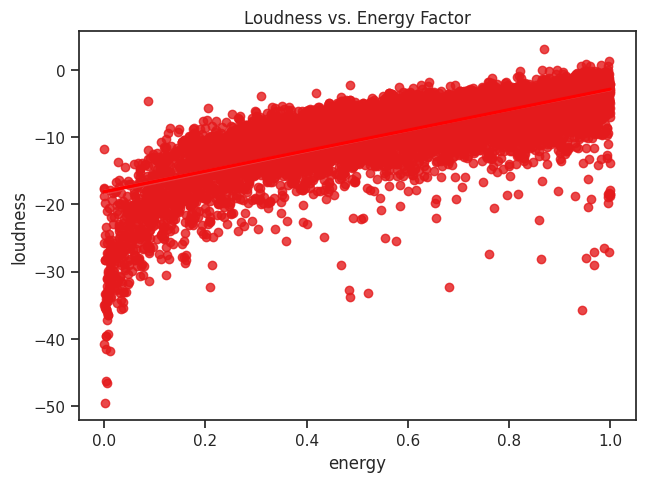

In [ ]:
# Intensity (Energy x Loudness)

sns.regplot(x='energy', y='loudness', data=df,line_kws={'color': 'red'})
plt.title('Loudness vs. Energy Factor')
plt.show()

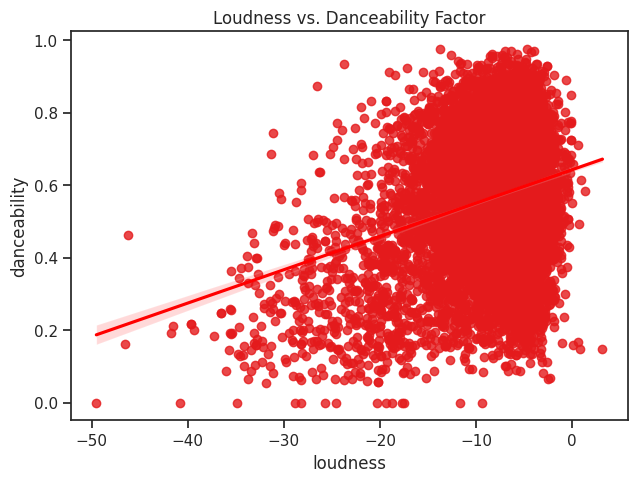

In [ ]:
# Liveliness (Loudness x Danceability)

sns.regplot(x='loudness', y='danceability', data=df,line_kws={'color': 'red'})
plt.title('Loudness vs. Danceability Factor')
plt.show()

In [ ]:
# Grooviness (Speechiness, Energy, Danceability)

fig = px.scatter_3d(df, x='speechiness', y='energy', z='danceability', color = 'popularity')
fig.show()

# Final dataset